## Table of contents
* [Introduction](#introduction)
* [Business problem](#businessproblem)
* [Data](#data)
* [Analysis](#analysis)
* [Results](#results)
* [Discussion](#discussion)
* [Conclusion](#conclusion)

### Introduction  <a name="introduction"></a>

Moving to another city is very exciting but also very stressful. 
Searching for a new place to stay for at least a year can be a nightmare, especially in a completely new city. 
Sometimes so many things need to be taken into account: rental prices, bus/train/metro stops, shops, schools or kindergartens or both nearby and so on.
Thus, it would be very helpful to reduce the area of search from the whole city to a group of neighbourhoods matching user's preferences.

### Business problem <a name="businessproblem"></a>

The aim of this capstone project is to find a neighbourhood (or group of neighbourhoods) in another city based on the current location of the user (or any preferred location).
Therefore, the question we are going to answer in the end of this project is: in which neighbourhood I should search an apartment to rent/to buy?

This project can be of particular interest for people who change their workplace frequently, such as, for example, people working in academia.

In [1]:
import pandas as pd
import numpy as np

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json
import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

import folium

from geopy.geocoders import Nominatim

from sklearn.cluster import KMeans

import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib.pyplot as pl
import seaborn as sns

In [2]:
from shapely.geometry import shape
from shapely.geometry import Point

In [3]:
from selenium import webdriver
import os
import time

In [4]:
# Workaround to save map as a picture. Is there any easy way?
def savemap(folium_map, name): 
    folium_map.save('{}.html'.format(name))
    
    tmpurl='file://{}/{}.html'.format(os.getcwd(), name)
    browser = webdriver.Firefox()
    browser.get(tmpurl)
    #Give the map tiles some time to load
    delay=5
    time.sleep(delay)
    browser.save_screenshot('{}.png'.format(name))
    browser.quit()

### Data <a name="data"></a>

For this project we will need the location of the current user address and location of the neighbourhoods in the new city.

GeoJson of Geneva neighbourhoods is taken from [Open Swiss data](https://opendata.swiss/en/dataset/__445). We will compute centers of each neighbourhood using `shapely` package. 

Current user address chosen arbitrary and set to *Chaussee de Wavre 442, Brussels, Belgium*, its latitude and longitude data will be extracted using `geopy` client.

To compare user's current address with the neighbourhoods in the new city, we will use `Foursquare API`. 
From this API we will request following information for each neighbourhood using its geoposition:

1. Venue
2. Name of the venue
3. Venue Latitude
4. Venue Longitude
5. Venue Category

We will take into consideration all types of venues: shops, restaurants, cafe, schools, parks and so on.
The search radius will be set to 1 km and we limit number of venues to 100.

We will use machine learning algorithm *k-means clustering* to define clusters of neighbourhoods in the new city, and then we compare the clusters to the chosen address. 

#### Inital address

Let's see what is the current neighbourhood and what is around.
First, we will get geo position of the home address using `geopy`:

In [5]:
address = 'Belgium, Brussels, chaussee de wavre 442'
geolocator = Nominatim(user_agent="Brussels_test")
location = geolocator.geocode(address)
latitude_home = location.latitude
longitude_home = location.longitude
print('The geograpical coordinate of the input address are {}, {}.'.format(latitude_home, longitude_home))

The geograpical coordinate of the input address are 50.8356068, 4.38230692110629.


Now, with help of `Foursquare API`, we will check what venues we have in 1 km radius and plot them on the map along with the home address

In [89]:
CLIENT_ID = '' # your Foursquare ID
CLIENT_SECRET = '' # your Foursquare Secret
VERSION = '' # Foursquare API version
LIMIT = 100 # A default Foursquare API limit value
radius = 1000 # Set radius to 1km

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: 
CLIENT_SECRET:


In [7]:
def getNearbyVenues(names, latitudes, longitudes, radius):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Borough', 
                  'Latitude', 
                  'Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [8]:
home_venues = getNearbyVenues([address], [latitude_home], [longitude_home], radius)

Belgium, Brussels, chaussee de wavre 442


In [9]:
home_venues.head()

,Borough,Latitude,Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,"Belgium, Brussels, chaussee de wavre 442",50.835607,4.382307,Eccetera,50.836300,4.381610,Italian Restaurant
1,"Belgium, Brussels, chaussee de wavre 442",50.835607,4.382307,Il Gelato,50.837343,4.381220,Ice Cream Shop
2,"Belgium, Brussels, chaussee de wavre 442",50.835607,4.382307,Sofitel Brussels Europe,50.837720,4.381183,Hotel
3,"Belgium, Brussels, chaussee de wavre 442",50.835607,4.382307,Stirwen,50.836494,4.381994,Belgian Restaurant
4,"Belgium, Brussels, chaussee de wavre 442",50.835607,4.382307,Théâtre Varia,50.834743,4.378773,Theater


In [10]:
print('There are {} uniques categories near {}'.format(len(home_venues['Venue Category'].unique()), 
                                                       home_venues['Borough'][0]))

There are 62 uniques categories near Belgium, Brussels, chaussee de wavre 442


Now let's see the discovered venues on the map using `Folium`

In [11]:
map_ = folium.Map(location=[latitude_home, longitude_home], zoom_start=15)
label = home_venues['Borough'][0]
label = folium.Popup(label, parse_html=True)
folium.CircleMarker(
            [latitude_home, longitude_home],
            radius=5,
            popup=label,
            color='red',
            fill=True,
            fill_color='#cc6f31',
            fill_opacity=0.7,
            parse_html=False).add_to(map_)
for lat, lng, category in zip(home_venues['Venue Latitude'], 
                              home_venues['Venue Longitude'], 
                              home_venues['Venue Category']):
        label = '{}'.format(category)
        label = folium.Popup(label, parse_html=True)
        folium.CircleMarker(
            [lat, lng],
            radius=5,
            popup=label,
            color='blue',
            fill=True,
            fill_color='#3186cc',
            fill_opacity=0.7,
            parse_html=False).add_to(map_)

# savemap(map_, "brussels")
map_

The place looks pretty packed! Let's see the places by category:

In [12]:
venues_df = home_venues['Venue Category'].to_frame()
venues_df['Category count']=1
venues_df = venues_df.groupby(['Venue Category']).sum().reset_index()
venues_df.sort_values('Category count',ascending=False).head(10)

,Venue Category,Category count
30,Italian Restaurant,8
3,Bakery,4
9,Coffee Shop,4
26,Hotel,3
44,Sandwich Place,3
8,Cocktail Bar,3
17,French Restaurant,3
40,Plaza,3
25,History Museum,3
23,Gym / Fitness Center,2


 This place is surrounded by restaurants, italian cuisine mostly, coffee shops and hotels. Thus in the new city we will be looking for the similar area. 
 
 One possible improvement to this study could be addition of weights. For example, if user prefers having a bus stop near by to italian restaurant, its frequency can be enhanced by some factor. 

 Now we are going to prepare the data for future clustering using one-hot encoding:

In [13]:
# one hot encoding
home_onehot = pd.get_dummies(home_venues[['Venue Category']], prefix="", prefix_sep="")

# add name column back to dataframe
home_onehot['Borough'] = address

# move name column to the first column
fixed_columns = [home_onehot.columns[-1]] + list(home_onehot.columns[:-1])
home_onehot = home_onehot[fixed_columns]

home_onehot.head()

,Borough,African Restaurant,Argentinian Restaurant,Bagel Shop,Bakery,Bar,Beer Store,Belgian Restaurant,Butcher,Cocktail Bar,Coffee Shop,Concert Hall,Diner,Doner Restaurant,Event Service,Exhibit,Fish & Chips Shop,Fish Market,French Restaurant,Fried Chicken Joint,Friterie,Garden,Greek Restaurant,Gym,Gym / Fitness Center,Health Food Store,History Museum,Hotel,Hotel Bar,Ice Cream Shop,Indian Restaurant,Italian Restaurant,Japanese Restaurant,Lounge,Mediterranean Restaurant,Modern European Restaurant,Museum,Park,Pastry Shop,Pizza Place,Playground,Plaza,Pool,Portuguese Restaurant,Restaurant,Sandwich Place,Science Museum,Shoe Store,Smoothie Shop,Snack Place,Souvlaki Shop,Spa,Steakhouse,Supermarket,Sushi Restaurant,Syrian Restaurant,Tapas Restaurant,Thai Restaurant,Theater,Toy / Game Store,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Wine Bar
0,"Belgium, Brussels, chaussee de wavre 442",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,"Belgium, Brussels, chaussee de wavre 442",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,"Belgium, Brussels, chaussee de wavre 442",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,"Belgium, Brussels, chaussee de wavre 442",0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,"Belgium, Brussels, chaussee de wavre 442",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0


In [14]:
home_onehot.shape

(100, 63)

#### New address

Now we are going to check the neighbourhoods in the city where the user is supposed to move, Geneva. To extract information about Geneva we are going to use an API from [Open Swiss data](https://opendata.swiss/en/dataset/__445).

In [15]:
S = requests.Session()
URL ='https://ge.ch/sitgags1/rest/services/VECTOR/SITG_OPENDATA_01/MapServer/5661/query?where=OBJECTID>0&f=geojson'

R = S.get(url=URL)
print(R.encoding) # default encoding is not good for french
R.encoding = 'utf-8'
DATA = R.json()
encodedUnicode = json.dumps(DATA, ensure_ascii=False)
DATA = json.loads(encodedUnicode)

ISO-8859-1


The `requests API` has default encoding `ISO-8859-1`, which is not good for french names, that is why we changed it to `utf-8`

Now we can compute locations of the commune centers and prepare the dataframe for the future analysis:

In [16]:
gva_dict={'Borough':[], 'Latitude':[], 'Longitude':[]}
for feature in DATA['features']:
    gva_dict['Borough'].append(feature['properties']['COMMUNE'])
    s = shape(feature["geometry"])
    gva_dict['Latitude'].append(s.centroid.y)
    gva_dict['Longitude'].append(s.centroid.x)

In [64]:
geneva_fin_df= pd.DataFrame.from_dict(gva_dict).sort_values('Borough')
print(geneva_fin_df.shape)
geneva_fin_df.head()

(48, 3)


,Borough,Latitude,Longitude
9,Aire-la-Ville,46.190231,6.042232
0,Anières,46.280835,6.222558
32,Avully,46.167463,5.998503
22,Avusy,46.149539,6.008849
4,Bardonnex,46.149001,6.118303


Now let's visualise the imported neighbourhoods with compute centers on the map using `Folium`. To center the map we will first take Geneva location:

In [18]:
address_new = 'Switzerland, Geneva'
geolocator = Nominatim(user_agent="Geneva_test")
location = geolocator.geocode(address_new)
latitude_new = location.latitude
longitude_new = location.longitude
print('The geograpical coordinate of Geneva are {}, {}.'.format(latitude_new, longitude_new))

The geograpical coordinate of Geneva are 46.2017559, 6.1466014.


To make it look a bit better on the map we will add a small shift in latitude:

In [19]:
latitude_new = latitude_new+0.05

In [20]:
geneva_map = folium.Map([latitude_new, longitude_new], zoom_start=11)

choropleth = folium.Choropleth(
    geo_data=DATA,
    name="choropleth",
    key_on='feature.properties.COMMUNE',
    fill_color="orange",
    fill_opacity=0.3,
    line_opacity=0.7,
).add_to(geneva_map)

for feature in DATA['features']:
    choropleth.geojson.add_child(
        folium.features.GeoJsonTooltip(['COMMUNE'], [feature['properties']['COMMUNE']], labels=False)
    )

for lat, lng, neighborhood in zip(geneva_fin_df['Latitude'], 
                                  geneva_fin_df['Longitude'], 
                                  geneva_fin_df['Borough']):
        label = '{} center'.format(neighborhood)
        label = folium.Popup(label, parse_html=True)
        folium.CircleMarker(
            [lat, lng],
            radius=2,
            popup=label,
            color='red',
            fill=True,
            fill_color='#cc6f31',
            fill_opacity=0.7,
            parse_html=False).add_to(geneva_map)

# folium.LayerControl().add_to(geneva_map)
geneva_map

As we can see some of the centers fall in the water (Hermance and Anières) and one is outside the area (Gy). However, taking into account the search radius this should not be a problem in this study.

Now let's see venues around commune centers:

In [21]:
geneva_venues = getNearbyVenues(geneva_fin_df['Borough'], 
                                geneva_fin_df['Latitude'], 
                                geneva_fin_df['Longitude'], 
                                1000) # radius 1km
geneva_venues.head()

Aire-la-Ville
Anières
Avully
Avusy
Bardonnex
Bellevue
Bernex
Carouge
Cartigny
Chancy
Choulex
Chêne-Bougeries
Chêne-Bourg
Collex-Bossy
Collonge-Bellerive
Cologny
Confignon
Corsier
Céligny
Dardagny
Genthod
Genève-Cité
Genève-Eaux-Vives
Genève-Petit-Saconnex
Genève-Plainpalais
Grand-Saconnex
Gy
Hermance
Jussy
Laconnex
Lancy
Meinier
Meyrin
Onex
Perly-Certoux
Plan-les-Ouates
Pregny-Chambésy
Presinge
Puplinge
Russin
Satigny
Soral
Thônex
Troinex
Vandoeuvres
Vernier
Versoix
Veyrier


,Borough,Latitude,Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Aire-la-Ville,46.190231,6.042232,Café du Levant,46.190103,6.041817,Restaurant
1,Aire-la-Ville,46.190231,6.042232,Pro-Pose Sàrl,46.197032,6.049534,Accessories Store
2,Aire-la-Ville,46.190231,6.042232,BBS Transports Sàrl,46.197806,6.048044,Transportation Service
3,Aire-la-Ville,46.190231,6.042232,Le Chat Rouge,46.197105,6.050143,Mexican Restaurant
4,Anières,46.280835,6.222558,Le Floris,46.276930,6.222824,French Restaurant


In [22]:
geneva_venues.shape

(874, 7)

### Analysis <a name="analysis"></a>

Now we can study extracted data in a bit more details. First let's see how many vanues we found per borough

In [23]:
geneva_venues.groupby('Borough').count()

,Latitude,Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Borough,,,,,,
Aire-la-Ville,4,4,4,4,4,4
Anières,4,4,4,4,4,4
Avully,5,5,5,5,5,5
Avusy,4,4,4,4,4,4
Bardonnex,3,3,3,3,3,3
Bellevue,23,23,23,23,23,23
Bernex,4,4,4,4,4,4
Carouge,78,78,78,78,78,78
Cartigny,3,3,3,3,3,3


In [24]:
print('There are {} uniques categories.'.format(len(geneva_venues['Venue Category'].unique())))

There are 176 uniques categories.


We can see that some neighbourhoods reached maximum 100 venues and some barely have 1. In total we have 176 unique venues. 

Let's localise the neighbourhoods and their venues on the map.

In [25]:
map_ = folium.Map(location=[latitude_new, longitude_new], zoom_start=11)
for bor, lat, lng in zip(geneva_venues['Borough'], 
                         geneva_venues['Latitude'], 
                         geneva_venues['Longitude']):
    
        label = bor
        label = folium.Popup(label, parse_html=True)
        folium.CircleMarker(
                    [lat, lng],
                    radius=5,
                    popup=label,
                    color='red',
                    fill=True,
                    fill_color='#cc6f31',
                    fill_opacity=0.7,
                    parse_html=False).add_to(map_)
for lat, lng, category in zip(geneva_venues['Venue Latitude'], 
                              geneva_venues['Venue Longitude'], 
                              geneva_venues['Venue Category']):
        label = '{}'.format(category)
        label = folium.Popup(label, parse_html=True)
        folium.CircleMarker(
            [lat, lng],
            radius=5,
            popup=label,
            color='blue',
            fill=True,
            fill_color='#3186cc',
            fill_opacity=0.7,
            parse_html=False).add_to(map_)
map_

We see that the most venues are concentrated near the city center. Let's plot the same but using `Choropleth` map

In [26]:
geneva_map = folium.Map([latitude_new, longitude_new], zoom_start=11)

choropleth = folium.Choropleth(
    geo_data=DATA,
    name="choropleth",
    data=geneva_venues.groupby('Borough').count().reset_index(),
    columns=["Borough", "Venue Category"],
    key_on='feature.properties.COMMUNE',
    threshold_scale=np.linspace(0, 100, 10),
    fill_color="YlOrRd",
    fill_opacity=0.7,
    line_opacity=0.7,
    legend_name="Number of discovred venues",
).add_to(geneva_map)

for feature in DATA['features']:
    choropleth.geojson.add_child(
        folium.features.GeoJsonTooltip(['COMMUNE'], [feature['properties']['COMMUNE']], labels=False)
    )
# savemap(geneva_map, "geneva")
geneva_map

From the map we can see that the highest density of venues is located around city center, while in the communes in outskirts we found less than 10 venues. We also can see that in some places better segmentation would possibly increase number of venues (Bernex and Satigny for example). This can be one of improvements of the analysis.

Now we can prepare data for the clustering. First we will do one-hot encoding: 

In [27]:
# one hot encoding
geneva_onehot = pd.get_dummies(geneva_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
geneva_onehot['Borough'] = geneva_venues['Borough'] 

# move neighborhood column to the first column
fixed_columns = [geneva_onehot.columns[-1]] + list(geneva_onehot.columns[:-1])
geneva_onehot = geneva_onehot[fixed_columns]

geneva_onehot.head()

,Borough,Accessories Store,African Restaurant,Airport,Airport Lounge,Airport Service,Airport Terminal,Art Gallery,Art Museum,Asian Restaurant,Athletics & Sports,Automotive Shop,BBQ Joint,Bakery,Bar,Beach,Beach Bar,Bistro,Board Shop,Boat or Ferry,Bookstore,Border Crossing,Boutique,Bowling Alley,Brazilian Restaurant,Breakfast Spot,Brewery,Buffet,Burger Joint,Bus Station,Bus Stop,Business Service,Café,Campground,Candy Store,Car Wash,Chinese Restaurant,Chocolate Shop,Church,Cocktail Bar,Coffee Shop,Comedy Club,Concert Hall,Construction & Landscaping,Convenience Store,Coworking Space,Cupcake Shop,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Dive Bar,Eastern European Restaurant,Electronics Store,Escape Room,Ethiopian Restaurant,Event Service,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Fondue Restaurant,Food,Fountain,French Restaurant,Furniture / Home Store,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,General Travel,Golf Course,Gourmet Shop,Grocery Store,Gun Range,Gym,Gym / Fitness Center,Harbor / Marina,Hardware Store,Health & Beauty Service,History Museum,Home Service,Hospital,Hotel,Hotel Bar,IT Services,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Kebab Restaurant,Korean Restaurant,Lake,Locksmith,Lounge,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Moroccan Restaurant,Movie Theater,Moving Target,Multiplex,Museum,Music Venue,Neighborhood,Nightclub,Noodle House,Other Great Outdoors,Outdoor Sculpture,Park,Performing Arts Venue,Peruvian Restaurant,Pet Store,Pharmacy,Pier,Pizza Place,Playground,Plaza,Pool,Portuguese Restaurant,Pub,Ramen Restaurant,Restaurant,River,Salon / Barbershop,Sandwich Place,Scenic Lookout,Seafood Restaurant,Shopping Mall,Skate Park,Skating Rink,Snack Place,Soccer Field,Soccer Stadium,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Shop,Stables,Steakhouse,Street Food Gathering,Supermarket,Sushi Restaurant,Swiss Restaurant,Taco Place,Tapas Restaurant,Tea Room,Tennis Court,Tennis Stadium,Thai Restaurant,Theater,Theme Park,Thrift / Vintage Store,Tourist Information Center,Trail,Train Station,Tram Station,Transportation Service,Trattoria/Osteria,Turkish Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Vineyard,Waste Facility,Waterfront,Wine Bar,Wine Shop,Winery,Women's Store
0,Aire-la-Ville,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,Aire-la-Ville,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,Aire-la-Ville,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
3,Aire-la-Ville,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,Anières,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

In [28]:
geneva_onehot.shape

(874, 177)

Now we must ensure that we have all the same features in our Brussels and Geneva dataframes. For this we will merge the two. NaN we will drop.

Some rows may have all 0, they are kept in order to preseve 'true' frequency of left venues.

In [29]:
combined_onehot_df = pd.concat([geneva_onehot,home_onehot], axis=0, ignore_index=True, sort=True).dropna(axis=1)
combined_onehot_df.head()

,African Restaurant,Bakery,Bar,Borough,Cocktail Bar,Coffee Shop,Concert Hall,Diner,Event Service,French Restaurant,Garden,Gym,Gym / Fitness Center,History Museum,Hotel,Hotel Bar,Ice Cream Shop,Indian Restaurant,Italian Restaurant,Japanese Restaurant,Lounge,Mediterranean Restaurant,Museum,Park,Pizza Place,Playground,Plaza,Pool,Portuguese Restaurant,Restaurant,Sandwich Place,Snack Place,Spa,Steakhouse,Supermarket,Sushi Restaurant,Tapas Restaurant,Thai Restaurant,Theater,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Wine Bar
0,0,0,0,Aire-la-Ville,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,Aire-la-Ville,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,Aire-la-Ville,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,Aire-la-Ville,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,Anières,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


and finally we can group by 'Borough':

In [30]:
combined_onehot_df = combined_onehot_df.groupby('Borough').mean().reset_index()
combined_onehot_df.head()

,Borough,African Restaurant,Bakery,Bar,Cocktail Bar,Coffee Shop,Concert Hall,Diner,Event Service,French Restaurant,Garden,Gym,Gym / Fitness Center,History Museum,Hotel,Hotel Bar,Ice Cream Shop,Indian Restaurant,Italian Restaurant,Japanese Restaurant,Lounge,Mediterranean Restaurant,Museum,Park,Pizza Place,Playground,Plaza,Pool,Portuguese Restaurant,Restaurant,Sandwich Place,Snack Place,Spa,Steakhouse,Supermarket,Sushi Restaurant,Tapas Restaurant,Thai Restaurant,Theater,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Wine Bar
0,Aire-la-Ville,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.25,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,Anières,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.250000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.25,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,Avully,0.0,0.0,0.0,0.0,0.0,0.0,0.2,0.0,0.000000,0.2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,Avusy,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.250000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,Bardonnex,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.666667,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [31]:
# Check in case we have a row with all 0
combined_onehot_df.loc[(combined_onehot_df.iloc[:]==0).all(1)]

,Borough,African Restaurant,Bakery,Bar,Cocktail Bar,Coffee Shop,Concert Hall,Diner,Event Service,French Restaurant,Garden,Gym,Gym / Fitness Center,History Museum,Hotel,Hotel Bar,Ice Cream Shop,Indian Restaurant,Italian Restaurant,Japanese Restaurant,Lounge,Mediterranean Restaurant,Museum,Park,Pizza Place,Playground,Plaza,Pool,Portuguese Restaurant,Restaurant,Sandwich Place,Snack Place,Spa,Steakhouse,Supermarket,Sushi Restaurant,Tapas Restaurant,Thai Restaurant,Theater,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Wine Bar


After ensuring that the two dataframes have the same features and there are no empty boroughs, we can split them back and proceed with clustering and comparison.

In [32]:
geneva_onehot_fin = combined_onehot_df[combined_onehot_df['Borough']!=address]
geneva_onehot_fin.shape

(48, 42)

In [33]:
brussels_onehot_fin = combined_onehot_df[combined_onehot_df['Borough']==address]
brussels_onehot_fin.shape

(1, 42)

At this point we have two dataframes with the same number of features. Each feature is assigned with a number related to its appearance frequency.

Now we try to find similarities in boroughs of Geneva using k-means clustering. To find optimal K we will use elbow method with the help of the pack `yellowbrick`.

In [34]:
from sklearn.cluster import KMeans
from yellowbrick.cluster.elbow import kelbow_visualizer

In [35]:
geneva_onehot_fin.head()

,Borough,African Restaurant,Bakery,Bar,Cocktail Bar,Coffee Shop,Concert Hall,Diner,Event Service,French Restaurant,Garden,Gym,Gym / Fitness Center,History Museum,Hotel,Hotel Bar,Ice Cream Shop,Indian Restaurant,Italian Restaurant,Japanese Restaurant,Lounge,Mediterranean Restaurant,Museum,Park,Pizza Place,Playground,Plaza,Pool,Portuguese Restaurant,Restaurant,Sandwich Place,Snack Place,Spa,Steakhouse,Supermarket,Sushi Restaurant,Tapas Restaurant,Thai Restaurant,Theater,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Wine Bar
0,Aire-la-Ville,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.25,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,Anières,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.250000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.25,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,Avully,0.0,0.0,0.0,0.0,0.0,0.0,0.2,0.0,0.000000,0.2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,Avusy,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.250000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,Bardonnex,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.666667,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


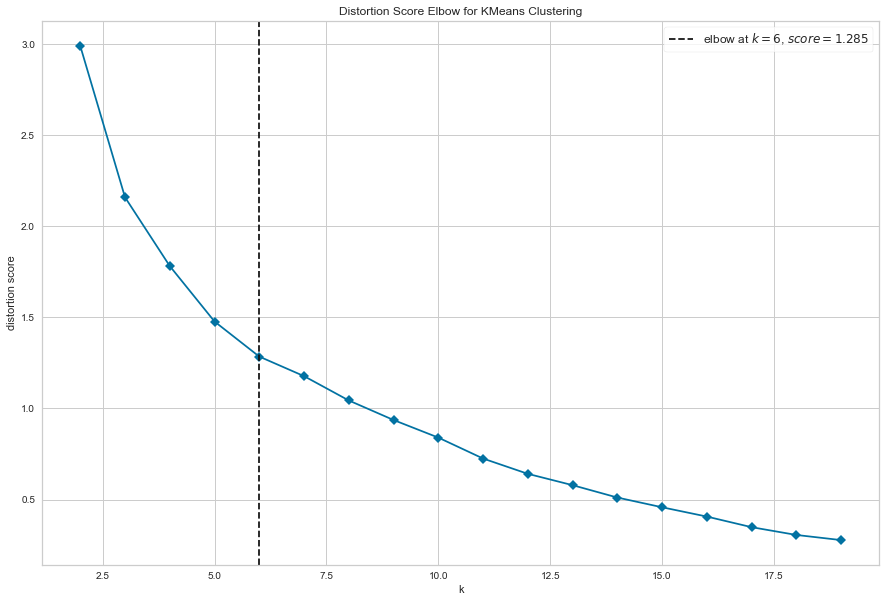

In [36]:
geneva_onehot_fin_cl = geneva_onehot_fin.drop('Borough',1)
vis = kelbow_visualizer(KMeans(random_state=0), geneva_onehot_fin_cl, k=(2,20), timings=False, size=(1080, 720))
vis.show()

In [57]:
kclusters = 6
kmeans = KMeans(n_clusters=kclusters, random_state=1).fit(geneva_onehot_fin_cl)
kmeans.labels_

array([3, 1, 0, 1, 4, 5, 0, 5, 3, 4, 1, 5, 5, 1, 5, 5, 1, 1, 1, 1, 4, 5,
       5, 5, 5, 5, 2, 1, 5, 1, 5, 0, 5, 5, 3, 1, 1, 3, 5, 1, 1, 1, 5, 4,
       3, 5, 3, 3], dtype=int32)

In [65]:
geneva_fin_df['Cluster Labels'] =  kmeans.labels_
geneva_fin_df.head()

,Borough,Latitude,Longitude,Cluster Labels
9,Aire-la-Ville,46.190231,6.042232,3
0,Anières,46.280835,6.222558,1
32,Avully,46.167463,5.998503,0
22,Avusy,46.149539,6.008849,1
4,Bardonnex,46.149001,6.118303,4


Now we can put clustres on the map and see where we have clusters

In [71]:
geneva_map = folium.Map([latitude_new, longitude_new], zoom_start=11)

choropleth = folium.Choropleth(
    geo_data=DATA,
    name="choropleth",
    data=geneva_fin_df,
    columns=["Borough", "Cluster Labels"],
    key_on='feature.properties.COMMUNE',
    threshold_scale=np.linspace(0, kclusters, kclusters+1),
    fill_color="YlGnBu",
    fill_opacity=0.9,
    line_opacity=0.7,
    legend_name="Cluster ID",
).add_to(geneva_map)

for lat, lng, score, neighborhood in zip(geneva_fin_df['Latitude'], 
                                         geneva_fin_df['Longitude'], 
                                         geneva_fin_df['Cluster Labels'], 
                                         geneva_fin_df['Borough']):
        label = '{} center \n cluster = {}'.format(neighborhood, score)
        label = folium.Popup(label, parse_html=True)
        folium.Marker(
            [lat, lng],
            radius=2,
            popup=label,
            color='red',
            fill=True,
            fill_color='#cc6f31',
            fill_opacity=0.9,
            line_opacity=0.9,
            parse_html=False).add_to(geneva_map)

for feature in DATA['features']:
    choropleth.geojson.add_child(
        folium.features.GeoJsonTooltip(['COMMUNE'], [feature['properties']['COMMUNE']], labels=False)
    )

# savemap(geneva_map, "geneva_kmeans")
geneva_map

Now let's see why the communes were clustered together. For this we will add top 5 venues in the `geneva_fin_df` dataframe

In [67]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [68]:
num_top_venues = 5

indicators = ['st', 'nd', 'rd']

columns = ["Borough"]
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

tmp_df = pd.DataFrame(columns=columns)
tmp_df['Borough'] = geneva_fin_df['Borough']

for ind in np.arange(geneva_onehot_fin.shape[0]):
    tmp_df.iloc[ind, 1:] = return_most_common_venues(geneva_onehot_fin.iloc[ind, :], 
                                                                          num_top_venues)

tmp_df.head()

,Borough,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
9,Aire-la-Ville,Restaurant,Wine Bar,Gym,Italian Restaurant,Indian Restaurant
0,Anières,Plaza,French Restaurant,Wine Bar,Gym,Italian Restaurant
32,Avully,Garden,Diner,Gym,Italian Restaurant,Indian Restaurant
22,Avusy,French Restaurant,Wine Bar,Gym,Italian Restaurant,Indian Restaurant
4,Bardonnex,French Restaurant,Wine Bar,Gym,Italian Restaurant,Indian Restaurant


Now let's merge it to the final geneva data frame:

In [69]:
geneva_fin_df = geneva_fin_df.merge(tmp_df,how='outer', on='Borough')
geneva_fin_df.head()

,Borough,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
0,Aire-la-Ville,46.190231,6.042232,3,Restaurant,Wine Bar,Gym,Italian Restaurant,Indian Restaurant
1,Anières,46.280835,6.222558,1,Plaza,French Restaurant,Wine Bar,Gym,Italian Restaurant
2,Avully,46.167463,5.998503,0,Garden,Diner,Gym,Italian Restaurant,Indian Restaurant
3,Avusy,46.149539,6.008849,1,French Restaurant,Wine Bar,Gym,Italian Restaurant,Indian Restaurant
4,Bardonnex,46.149001,6.118303,4,French Restaurant,Wine Bar,Gym,Italian Restaurant,Indian Restaurant


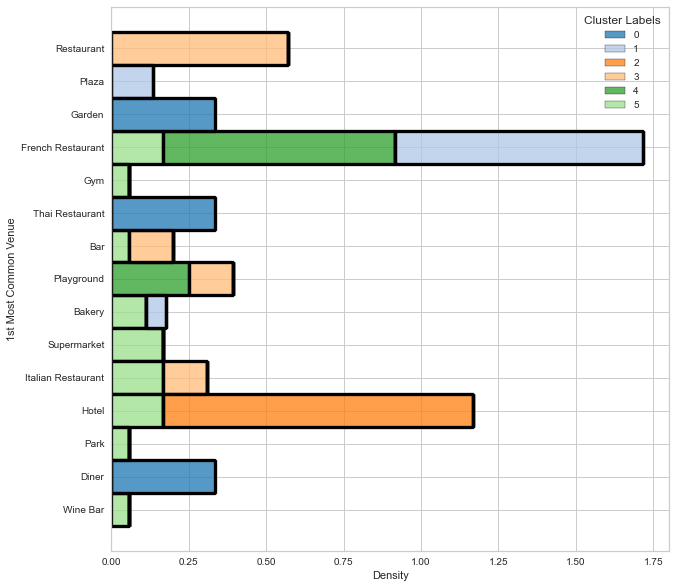

In [70]:
fig, ax = pl.subplots(figsize=(10,10))
ax1 = sns.histplot(y="1st Most Common Venue", hue="Cluster Labels", data=geneva_fin_df, 
             multiple="stack",
             ax=ax,
             palette = "tab20",
             stat="density", common_norm=False
            )
fig.savefig("cluster_top1venue.png")

Based on the cluster features, we can define following clusters:
 * Cluster 0: Calm boroughs with lots of diner places
 * Cluster 1: Calm boroughs with lots of french restaurants
 * Cluster 2: Calm touristic borough
 * Cluster 3: Borough with lots of places to go for dinner
 * Cluster 4: Calm borough for families with kids (lots of playgrounds, few venues)
 * Cluster 5: ‘Central’ touristic boroughs (includes areas with the city center and near lake areas)

Now we can finally compare cluster with our address in Brussels. First, let's extract cluster centers and vector of features for Brussels:

In [72]:
KM_centers = kmeans.cluster_centers_

In [73]:
brussels_vect = brussels_onehot_fin[brussels_onehot_fin.columns[1:]].T[5]

Now we will compute distance from each cluster center and Brussels features using [Euclidean distance](https://en.wikipedia.org/wiki/Euclidean_distance#:~:text=In%20mathematics%2C%20the%20Euclidean%20distance,being%20called%20the%20Pythagorean%20distance.)

In [74]:
from scipy.spatial import distance

In [75]:
clus_id = 0
eucl_dist = []
for feature in KM_centers:
    dist = distance.euclidean(feature, brussels_vect)
    print("Euclidean distance for Cluster {} is {:3f}".format(clus_id, dist))
    eucl_dist.append(dist)
    clus_id+=1

Euclidean distance for Cluster 0 is 0.278887
Euclidean distance for Cluster 1 is 0.239063
Euclidean distance for Cluster 2 is 0.980561
Euclidean distance for Cluster 3 is 0.284909
Euclidean distance for Cluster 4 is 0.509756
Euclidean distance for Cluster 5 is 0.096139


In [76]:
eucl_dict_fin = {'Borough':[], 'Euclidean distance':[]}
for bor, cl_id in zip(geneva_fin_df['Borough'], geneva_fin_df['Cluster Labels']):
    eucl_dict_fin['Borough'].append(bor)
    eucl_dict_fin['Euclidean distance'].append(eucl_dist[cl_id])

In [77]:
eucl_dist_df = pd.DataFrame.from_dict(eucl_dict_fin)
eucl_dist_df.head()

,Borough,Euclidean distance
0,Aire-la-Ville,0.284909
1,Anières,0.239063
2,Avully,0.278887
3,Avusy,0.239063
4,Bardonnex,0.509756


In [78]:
geneva_fin_df = geneva_fin_df.merge(eucl_dist_df,how='outer', on='Borough')
geneva_fin_df.head()

,Borough,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Euclidean distance
0,Aire-la-Ville,46.190231,6.042232,3,Restaurant,Wine Bar,Gym,Italian Restaurant,Indian Restaurant,0.284909
1,Anières,46.280835,6.222558,1,Plaza,French Restaurant,Wine Bar,Gym,Italian Restaurant,0.239063
2,Avully,46.167463,5.998503,0,Garden,Diner,Gym,Italian Restaurant,Indian Restaurant,0.278887
3,Avusy,46.149539,6.008849,1,French Restaurant,Wine Bar,Gym,Italian Restaurant,Indian Restaurant,0.239063
4,Bardonnex,46.149001,6.118303,4,French Restaurant,Wine Bar,Gym,Italian Restaurant,Indian Restaurant,0.509756


Finally, let's put Euclidian distance on the map

In [79]:
geneva_map = folium.Map([latitude_new, longitude_new], zoom_start=11)

choropleth = folium.Choropleth(
    geo_data=DATA,
    name="choropleth",
    data=geneva_fin_df,
    columns=["Borough", "Euclidean distance"],
    key_on='feature.properties.COMMUNE',
    threshold_scale=np.linspace(0, 1, 10),
    fill_color="YlGnBu_r",
    fill_opacity=0.7,
    line_opacity=0.7,
    legend_name="Similarity score",
).add_to(geneva_map)

for lat, lng, cl_id, score, neighborhood in zip(geneva_fin_df['Latitude'], 
                                         geneva_fin_df['Longitude'], 
                                         geneva_fin_df['Cluster Labels'], 
                                         geneva_fin_df['Euclidean distance'], 
                                         geneva_fin_df['Borough']):
        label = '{} \n cluster {} \n score = {:.3f}'.format(neighborhood, cl_id, score)
        label = folium.Popup(label, parse_html=True, show=False)
        folium.Marker(
            location=[lat, lng],
            popup=label,
            icon=folium.Icon(color="darkpurple", icon="info-sign"),
        ).add_to(geneva_map)
        
geneva_map

As we can see, the closets cluster to Brussels in terms of venues is cluster 5. The distance is 0.096

### Results<a name="results"></a>

Finally, we can present a map, where we show only the closest cluster.
For each borough we will give three most common venues:

In [80]:
final_df = geneva_fin_df[geneva_fin_df['Euclidean distance'] == np.min(geneva_fin_df['Euclidean distance'])]
final_df

,Borough,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Euclidean distance
5,Bellevue,46.254665,6.145282,5,Gym,Restaurant,Italian Restaurant,Mediterranean Restaurant,Spa,0.096139
7,Carouge,46.181673,6.140352,5,French Restaurant,Italian Restaurant,Bar,Supermarket,Plaza,0.096139
11,Chêne-Bougeries,46.193563,6.181689,5,Bakery,Restaurant,Plaza,Theater,Thai Restaurant,0.096139
12,Chêne-Bourg,46.197378,6.197007,5,Supermarket,Pizza Place,Restaurant,Bakery,Plaza,0.096139
14,Collonge-Bellerive,46.252159,6.198609,5,Italian Restaurant,Wine Bar,Lounge,Indian Restaurant,Ice Cream Shop,0.096139
15,Cologny,46.222820,6.180841,5,Bakery,Italian Restaurant,Diner,French Restaurant,History Museum,0.096139
21,Genève-Cité,46.206755,6.146280,5,Hotel,French Restaurant,Plaza,Bar,Restaurant,0.096139
22,Genève-Eaux-Vives,46.202380,6.164940,5,French Restaurant,Italian Restaurant,Steakhouse,Park,Coffee Shop,0.096139
23,Genève-Petit-Saconnex,46.217463,6.135547,5,Hotel,Park,Italian Restaurant,Supermarket,Bar,0.096139
24,Genève-Plainpalais,46.193499,6.141230,5,Bar,French Restaurant,Italian Restaurant,Restaurant,Pizza Place,0.096139


Let's print top 5 places for address in Brussels for comparison:

In [81]:
num_top_venues = 5

indicators = ['st', 'nd', 'rd']

columns = ["Borough", "Latitude", "Longitude"]
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

tmp_df = pd.DataFrame(columns=columns)
tmp_df['Borough'] = brussels_onehot_fin['Borough']
tmp_df['Latitude'] = home_venues['Latitude'].iloc[0]
tmp_df['Longitude'] = home_venues['Longitude'].iloc[0]

for ind in np.arange(brussels_onehot_fin.shape[0]):
    tmp_df.iloc[ind, 3:] = return_most_common_venues(brussels_onehot_fin.iloc[ind, :], 
                                                                          num_top_venues)

tmp_df.head()

,Borough,Latitude,Longitude,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
5,"Belgium, Brussels, chaussee de wavre 442",50.835607,4.382307,Italian Restaurant,Bakery,Coffee Shop,Plaza,Cocktail Bar


In [87]:
columns = ['Borough', 'Latitude', 'Longitude', '1st Most Common Venue', '2nd Most Common Venue', '3rd Most Common Venue']
print(tmp_df[columns].to_latex(index=False))

\begin{tabular}{lrrlll}
\toprule
                                  Borough &   Latitude &  Longitude & 1st Most Common Venue & 2nd Most Common Venue & 3rd Most Common Venue \\
\midrule
 Belgium, Brussels, chaussee de wavre 442 &  50.835607 &   4.382307 &    Italian Restaurant &                Bakery &           Coffee Shop \\
\bottomrule
\end{tabular}



And finally, let's produce the output map:

In [85]:
geneva_map = folium.Map([latitude_new, longitude_new], zoom_start=11)

choropleth = folium.Choropleth(
    geo_data=DATA,
    name="choropleth",
    data=final_df,
    columns=["Borough", "Euclidean distance"],
    key_on='feature.properties.COMMUNE',
    threshold_scale=np.linspace(0, 1, 10),
    fill_color="YlGnBu",
    fill_opacity=0.7,
    line_opacity=0.7,
    legend_name="Similarity score: the lower the better",
).add_to(geneva_map)

for lat, lng, score, top1, top2, top3, neighborhood in zip(final_df['Latitude'], 
                                                           final_df['Longitude'], 
                                                           final_df['Euclidean distance'], 
                                                           final_df['1st Most Common Venue'], 
                                                           final_df['2nd Most Common Venue'], 
                                                           final_df['3rd Most Common Venue'], 
                                                           final_df['Borough']):

        folium.Marker(
            location=[lat, lng],
            popup=("{} </br>"
                 'Score = {:.3f} </br>'
                 'Top places: {}, {}, {} </br>').format(neighborhood, 
                                                        score,
                                                        top1,
                                                        top2,
                                                        top3),
            icon=folium.Icon(color="blue", icon="info-sign"),
        ).add_to(geneva_map)

for feature in DATA['features']:
    choropleth.geojson.add_child(
        folium.features.GeoJsonTooltip(['COMMUNE'], [feature['properties']['COMMUNE']], labels=False)
    )
    
savemap(geneva_map, "geneva_final")
geneva_map

The final result of this project is a map with recommended boroughs, which we obtained by comparing cluster centroids with initial address.
Markers in the middle of the boroughs provide the name of the borough, similarity score (the lower the better) and top 3 most frequent venues.

### Discussion <a name="discussion"></a>

In this simple study we took into consideration only the surrounding venues, thus, to be more complete we would suggest to add rental prices, income rate and crime rate in the neighbourhoods of interest. Moreover, would be interesting to consider maximum distance from a possible workplace/study place etc.
Additionally, a feature filtering can be used to enhance the most preferred venues around.

Studying the boroughs of Geneva, we saw that some borough centers were very close to each other in comparison with the search radius. This caused overlapping venues in some neighbourhoods. The problem could be solved by segmenting the boroughs and reducing the search radius. The latter could add more precision to the final result.

Let's demonstrate the distance between borough centers with a plot. We can compute it using [Haversine_formula](https://en.wikipedia.org/wiki/Haversine_formula#:~:text=The%20haversine%20formula%20determines%20the,and%20angles%20of%20spherical%20triangles):

In [83]:
def getdistance(lat1, lng1, lat2, lng2):
    R = 6371000 # Radius of the Earth in m
    dlat = (lat2-lat1)*np.pi/180
    dlng = (lng2-lng1)*np.pi/180
    dist = 2*R* np.arcsin(np.sqrt(np.power(np.sin(dlat/2),2) +
                         np.cos(lat1*np.pi/180)*np.cos(lat2*np.pi/180)*
                         np.power(np.sin(dlng/2), 2)))
    return dist;

Small distance between Aire-la-Ville and Cartigny is 1807.25 m
Small distance between Anières and Corsier is 1685.86 m
Small distance between Bardonnex and Plan-les-Ouates is 1661.04 m
Small distance between Bellevue and Genthod is 1611.36 m
Small distance between Bellevue and Pregny-Chambésy is 1959.69 m
Small distance between Bernex and Confignon is 1656.05 m
Small distance between Carouge and Genève-Plainpalais is 1316.70 m
Small distance between Carouge and Lancy is 1636.73 m
Small distance between Cartigny and Laconnex is 1930.76 m
Small distance between Choulex and Puplinge is 1830.84 m
Small distance between Choulex and Vandoeuvres is 1750.06 m
Small distance between Chêne-Bougeries and Chêne-Bourg is 1253.02 m
Small distance between Chêne-Bougeries and Genève-Eaux-Vives is 1619.50 m
Small distance between Chêne-Bougeries and Thônex is 1785.25 m
Small distance between Chêne-Bourg and Thônex is 601.43 m
Small distance between Cologny and Vandoeuvres is 1806.82 m
Small distance be

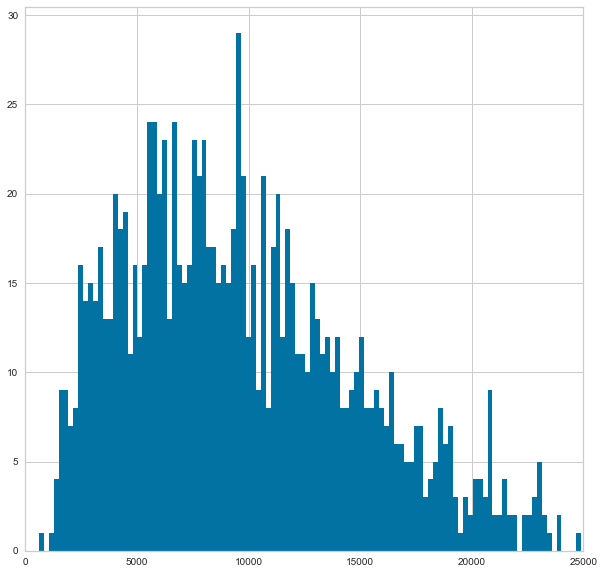

In [88]:
dist = []
for indx in geneva_fin_df[['Latitude', 'Longitude', 'Borough']].iterrows():
#     print('indx', indx[0])
    for indx1 in geneva_fin_df[['Latitude', 'Longitude', 'Borough']].iterrows():
        if indx[0]>=indx1[0]:
            continue
        dist_tmp = getdistance(indx[1][0], indx[1][1], indx1[1][0], indx1[1][1])
        if dist_tmp<2000:
            print('Small distance between {} and {} is {:.2f} m'.format(indx[1][2], 
                                                                        indx1[1][2],
                                                                        dist_tmp))
        dist.append(dist_tmp)

fig, ax = pl.subplots(figsize=(10,10))
pl.hist(dist, bins=125)
ax.set_xlim(0, 25000)
print("Minimal distance between borough centers is {:.2f} m".format(np.min(dist)))

Majority of the boroughs belong to the central area. Thus, one of the improvements could be reduction of the search radius from 1 km to 500 m. This would require more elaborated segmenting of large boroughs sich that they for sure have some venues in them.

### Conclusion <a name="conclusion"></a>

The aim of the project was in finding best location to move based on user inputs. Given the home address, Chaussee de Wavre 442, Brussels, Belgium, and the city of moving, Geneva, we found a group of boroughs, where the user can move based on venues around. As an output of the research we provide a map with recommended boroughs containing information about top 3 most frequent venues.

The final choice, however, must include many other factors, such as rental prices, proximity to work and so on, thus the study can be considered as a first step towards a final decision.